# Predicción de Precios de Alquileres en Airbnb en CDMX
## Introducción

En este notebook, se lleva a cabo un análisis exhaustivo y una predicción de los precios de alquileres de propiedades listadas en Airbnb en la Ciudad de México. Utilizando un conjunto de datos descargado de la [página oficial](https://insideairbnb.com/mexico-city/), se exploran diversas técnicas de análisis de datos y modelos de regresión para comprender los factores que influyen en los precios de alquiler y predecir futuros precios con base en distintas características de las propiedades.





## Configuración Inicial

In [1]:
# Importar biblioteca para Google Colab
from google.colab import drive

# Importar bibliotecas generales
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap
import sys
import warnings

# Configuración para ignorar advertencias
if not sys.warnoptions:
    warnings.simplefilter("ignore")

# Configuración para visualización en notebooks
%matplotlib inline

# Importar biblioteca para división de datos
from sklearn.model_selection import train_test_split

# Importar bibliotecas para evaluación de modelos
from sklearn.metrics import mean_absolute_error, mean_squared_error, accuracy_score, confusion_matrix, recall_score, precision_score, f1_score
from sklearn import metrics

# Importar bibliotecas para preprocesamiento
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn import preprocessing

# Importar bibliotecas para regresión lineal
from sklearn.linear_model import LinearRegression, LassoCV, LassoLarsCV

# Importar bibliotecas para regresión KNN
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_val_score

# Importar bibliotecas para clasificación KNN
from sklearn.neighbors import KNeighborsClassifier

# Importar bibliotecas para árbol de decisión
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

###  Carga de Datos

In [2]:
# Montar Google Drive
drive.mount('/content/drive')

# Leer el archivo CSV
df1 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/listings.csv', encoding='utf-8')

# Mostrar las primeras filas del DataFrame para exploración
df1.head()

Mounted at /content/drive


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,35797,Villa Dante,153786,Dici,NaN,Cuajimalpa de Morelos,19.38283,-99.27178,Entire home/apt,3663.0,1,0,NaN,NaN,1,363,0,NaN
1,898633,City SkyLine View from 1 Bedroom Apt in CDMX,4796027,Marco,NaN,Cuauhtémoc,19.42063,-99.16586,Entire home/apt,1652.0,3,56,2024-04-17,0.41,3,262,3,NaN
2,44616,CONDESA HAUS B&B,196253,Fernando,NaN,Cuauhtémoc,19.41162,-99.17794,Entire home/apt,18000.0,1,64,2023-03-26,0.42,13,364,0,NaN
3,913084,15 blocks from Paseo de la Reforma,4647293,Martina,NaN,Miguel Hidalgo,19.43956,-99.17263,Entire home/apt,814.0,2,161,2024-05-21,1.19,1,236,6,NaN
4,67703,"2 bedroom apt. deco bldg, Condesa",334451,Nicholas,NaN,Cuauhtémoc,19.41152,-99.16857,Entire home/apt,1923.0,2,49,2024-05-05,0.32,2,361,4,NaN


### Revisión y Limpieza de Datos



In [3]:
# Contar valores NaN en el DataFrame
total_nan = df1.isnull().sum().sum()
print(f'Total de valores NaN en el DataFrame: {total_nan}')

# Contar valores NaN en columnas específicas
nan_columns = {
    'name': df1['name'].isnull().sum(),
    'host_name': df1['host_name'].isnull().sum(),
    'reviews_per_month': df1['reviews_per_month'].isnull().sum(),
    'neighbourhood_group': df1['neighbourhood_group'].isnull().sum(),
    'last_review': df1['last_review'].isnull().sum()
}
print(f'Valores NaN por columna: {nan_columns}')

Total de valores NaN en el DataFrame: 64014
Valores NaN por columna: {'name': 0, 'host_name': 0, 'reviews_per_month': 3872, 'neighbourhood_group': 26536, 'last_review': 3872}


In [4]:
# Reemplazar valores NaN en algunas columnas
df1[['name', 'host_name']] = df1[['name', 'host_name']].fillna('None')
df1[['reviews_per_month']] = df1[['reviews_per_month']].fillna(0)

# Eliminar columnas con demasiados valores NaN
df2 = df1.drop(['neighbourhood_group', 'last_review','license'], axis=1)

In [5]:
# Crear una lista de condiciones para las delegaciones
conditions = [
    (df2['neighbourhood'] == 'Álvaro Obregón'),
    (df2['neighbourhood'] == 'Azcapotzalco'),
    (df2['neighbourhood'] == 'Benito Juárez'),
    (df2['neighbourhood'] == 'Coyoacán'),
    (df2['neighbourhood'] == 'Cuajimalpa de Morelos'),
    (df2['neighbourhood'] == 'Cuauhtémoc'),
    (df2['neighbourhood'] == 'Gustavo A. Madero'),
    (df2['neighbourhood'] == 'Iztacalco'),
    (df2['neighbourhood'] == 'Iztapalapa'),
    (df2['neighbourhood'] == 'Magdalena Contreras'),
    (df2['neighbourhood'] == 'Miguel Hidalgo'),
    (df2['neighbourhood'] == 'Milpa Alta'),
    (df2['neighbourhood'] == 'Tláhuac'),
    (df2['neighbourhood'] == 'Tlalpan'),
    (df2['neighbourhood'] == 'Venustiano Carranza'),
    (df2['neighbourhood'] == 'Xochimilco')
]

# Crear una lista de valores abreviados para cada condición
values = [
    'AO', 'AZ', 'BJ', 'CO', 'CM',
    'CU', 'GA', 'IZ', 'IP', 'MC',
    'MH', 'MA', 'TL', 'TP', 'VC', 'XO'
]

# Crear una nueva columna 'delegation' y asignar valores usando np.select
df2['delegation'] = np.select(conditions, values, default='Other')

# Mostrar el DataFrame actualizado
df2.head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,delegation
0,35797,Villa Dante,153786,Dici,Cuajimalpa de Morelos,19.38283,-99.27178,Entire home/apt,3663.0,1,0,0.00,1,363,0,CM
1,898633,City SkyLine View from 1 Bedroom Apt in CDMX,4796027,Marco,Cuauhtémoc,19.42063,-99.16586,Entire home/apt,1652.0,3,56,0.41,3,262,3,CU
2,44616,CONDESA HAUS B&B,196253,Fernando,Cuauhtémoc,19.41162,-99.17794,Entire home/apt,18000.0,1,64,0.42,13,364,0,CU
3,913084,15 blocks from Paseo de la Reforma,4647293,Martina,Miguel Hidalgo,19.43956,-99.17263,Entire home/apt,814.0,2,161,1.19,1,236,6,MH
4,67703,"2 bedroom apt. deco bldg, Condesa",334451,Nicholas,Cuauhtémoc,19.41152,-99.16857,Entire home/apt,1923.0,2,49,0.32,2,361,4,CU


## Análisis Exploratorio de Datos

In [6]:
# Mostrar información general del DataFrame
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26536 entries, 0 to 26535
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              26536 non-null  int64  
 1   name                            26536 non-null  object 
 2   host_id                         26536 non-null  int64  
 3   host_name                       26536 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   26536 non-null  object 
 6   latitude                        26536 non-null  float64
 7   longitude                       26536 non-null  float64
 8   room_type                       26536 non-null  object 
 9   price                           23338 non-null  float64
 10  minimum_nights                  26536 non-null  int64  
 11  number_of_reviews               26536 non-null  int64  
 12  last_review                     

In [7]:
# Análisis de la columna 'name'
df2.name.unique()

# Contar y visualizar los tipos de habitación
df2.room_type.value_counts()

,count
room_type,
Entire home/apt,17432
Private room,8581
Shared room,401
Hotel room,122


In [8]:
# Estadísticas descriptivas del DataFrame
print(df2.describe(include='all'))

                  id                                            name  \
count   2.653600e+04                                           26536   
unique           NaN                                           25129   
top              NaN  Blueground | Roma Sur 1 recamara, AC & rooftop   
freq             NaN                                              57   
mean    4.956689e+17                                             NaN   
std     4.691108e+17                                             NaN   
min     3.579700e+04                                             NaN   
25%     3.897687e+07                                             NaN   
50%     6.318684e+17                                             NaN   
75%     9.400505e+17                                             NaN   
max     1.187619e+18                                             NaN   

             host_id  host_name neighbourhood      latitude     longitude  \
count   2.653600e+04      26536         26536  26536.00000

<ipython-input-9-140f827c5358>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(x='Delegación', y='Frecuencia', data=delegation_count, palette='viridis')


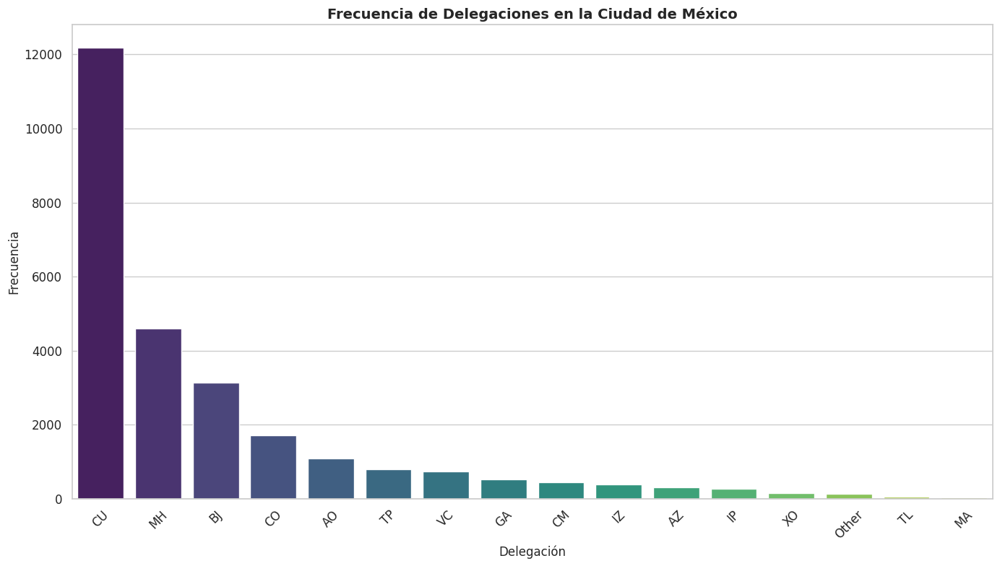

In [9]:
# Contar las frecuencias de las delegaciones
delegation_count = df2['delegation'].value_counts().reset_index()
delegation_count.columns = ['Delegación', 'Frecuencia']

# Crear el gráfico de barras
sns.set(style="whitegrid")
plt.figure(figsize=(14, 8))
barplot = sns.barplot(x='Delegación', y='Frecuencia', data=delegation_count, palette='viridis')

# Personalizar el gráfico
plt.title('Frecuencia de Delegaciones en la Ciudad de México', fontsize=14, fontweight='bold')
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

# Mostrar el gráfico
plt.show()

### Detección de Valores Atípicos



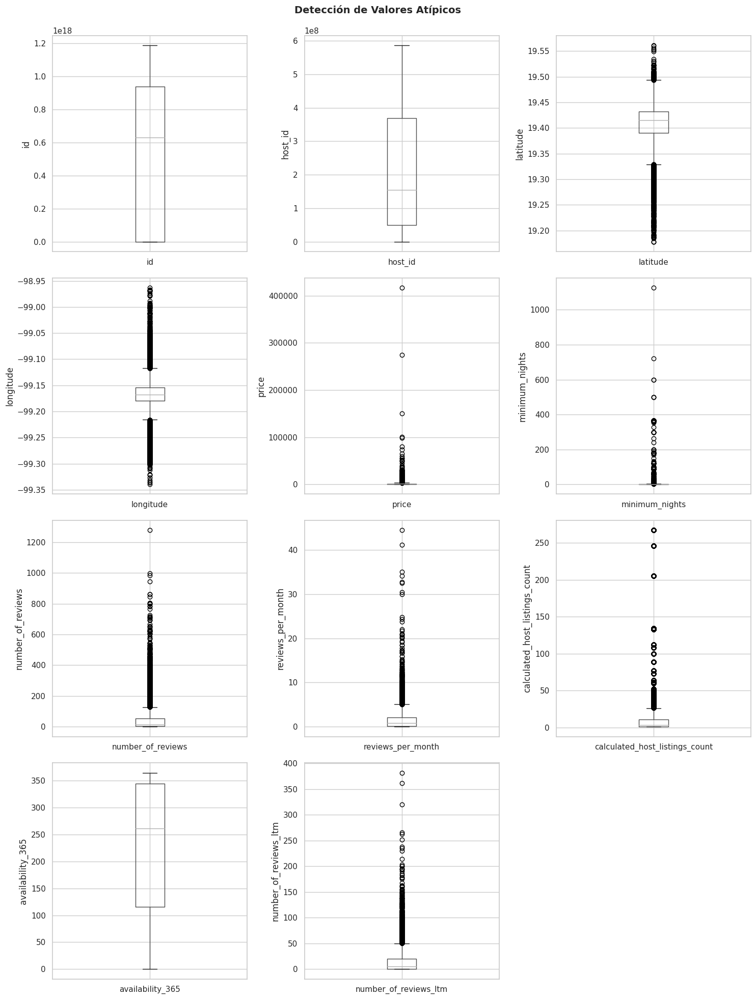

In [10]:
# Seleccionar solo las columnas numéricas
numeric_columns = df2.select_dtypes(include=[np.number]).columns

# Número de columnas numéricas
num_columns = len(numeric_columns)

# Crear una figura con subplots en una cuadrícula de 4x3
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(15, 20))

# Aplanar los ejes para iterar fácilmente si es necesario
axes = axes.flatten()

# Iterar sobre cada columna numérica y crear un boxplot en un subplot
for i, column in enumerate(numeric_columns):
    df2.boxplot(column=column, ax=axes[i])
    axes[i].set_ylabel(column)

# Eliminar subplots vacíos si hay menos de 12 columnas
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Añadir un título general a la figura
fig.suptitle('Detección de Valores Atípicos', fontsize=14, fontweight='bold')

# Ajustar el layout para que no se solapen los subplots y el título general
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

In [11]:
# Eliminar la columna 'host_id'
df3 = df2.drop(['host_id'], axis=1)

### Análisis de Correlación y Visualización

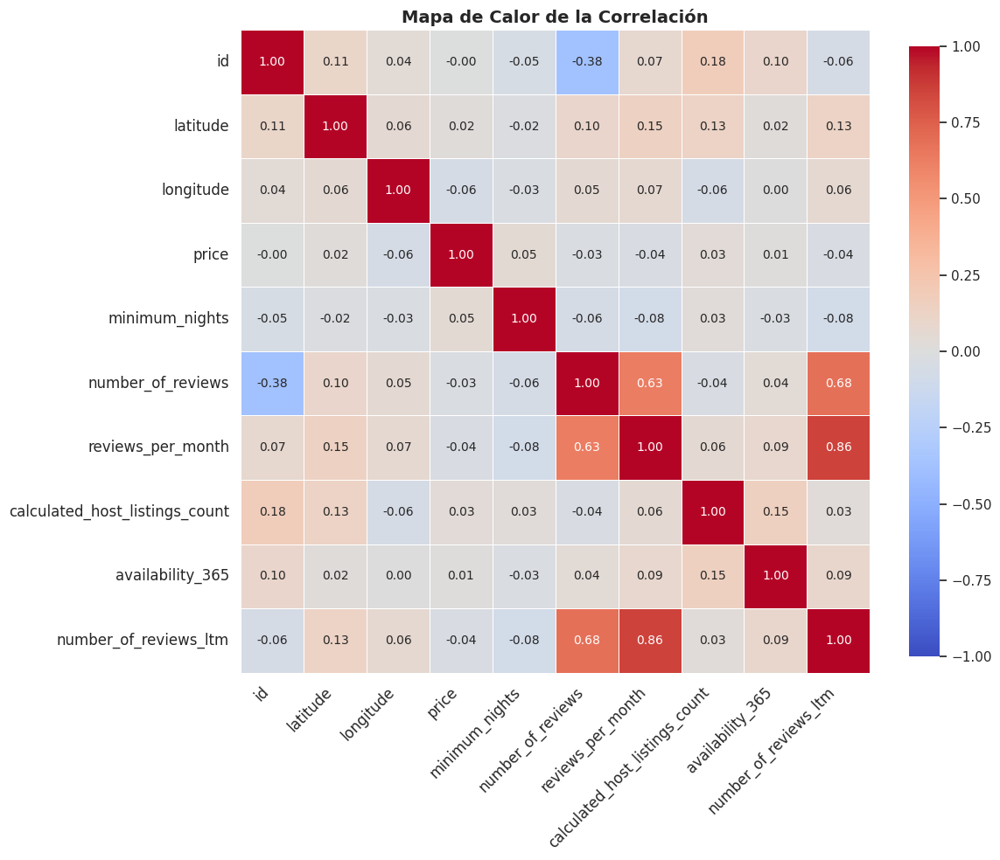

In [12]:
# Seleccionar solo las columnas numéricas
numeric_df = df3.select_dtypes(include=[np.number])

# Calcular la matriz de correlación
corr1 = numeric_df.corr()

# Crear el mapa de calor
plt.figure(figsize=(12, 10))
heatmap = sns.heatmap(corr1,
                      cmap='coolwarm',        # Paleta de colores mejorada
                      annot=True,              # Mostrar anotaciones
                      fmt='.2f',              # Formato de las anotaciones
                      annot_kws={"size": 10}, # Tamaño de las anotaciones
                      linewidths=.5,          # Ancho de las líneas de división
                      vmin=-1, vmax=1,        # Escala de colores para correlación
                      cbar_kws={"shrink": .95} # Ajustar el tamaño de la barra de color
                     )

# Ajustar el título y etiquetas
plt.title('Mapa de Calor de la Correlación', fontsize=14, fontweight='bold')
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(rotation=0, fontsize=12)
plt.tight_layout()  # Ajustar el diseño para evitar la superposición

# Mostrar el mapa de calor
plt.show()

<ipython-input-13-15d886e34789>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=room_type_counts.values, y=room_type_counts.index, palette='pastel', edgecolor='black')


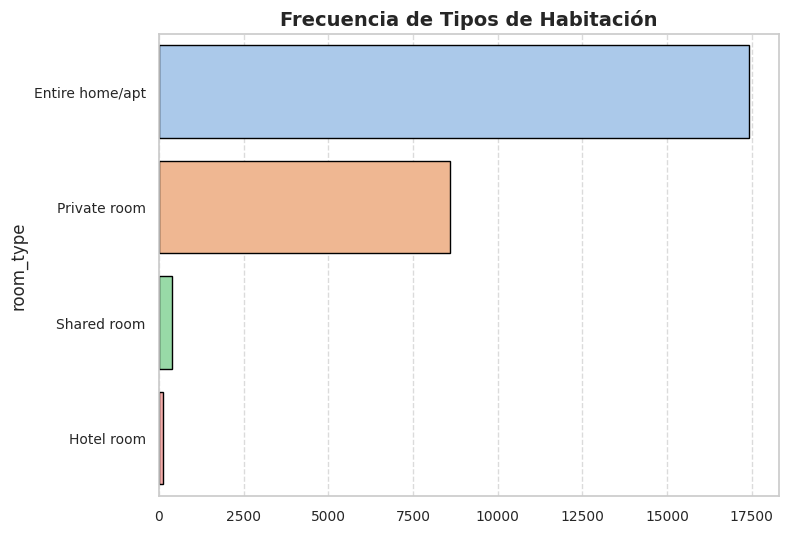

In [13]:
# Contar los tipos de habitación
room_type_counts = df3['room_type'].value_counts()

# Crear el gráfico de barras horizontales
plt.figure(figsize=(8, 6))
sns.barplot(x=room_type_counts.values, y=room_type_counts.index, palette='pastel', edgecolor='black')

# Mejorar la estética del gráfico
plt.title('Frecuencia de Tipos de Habitación', fontsize=14, fontweight='bold')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()

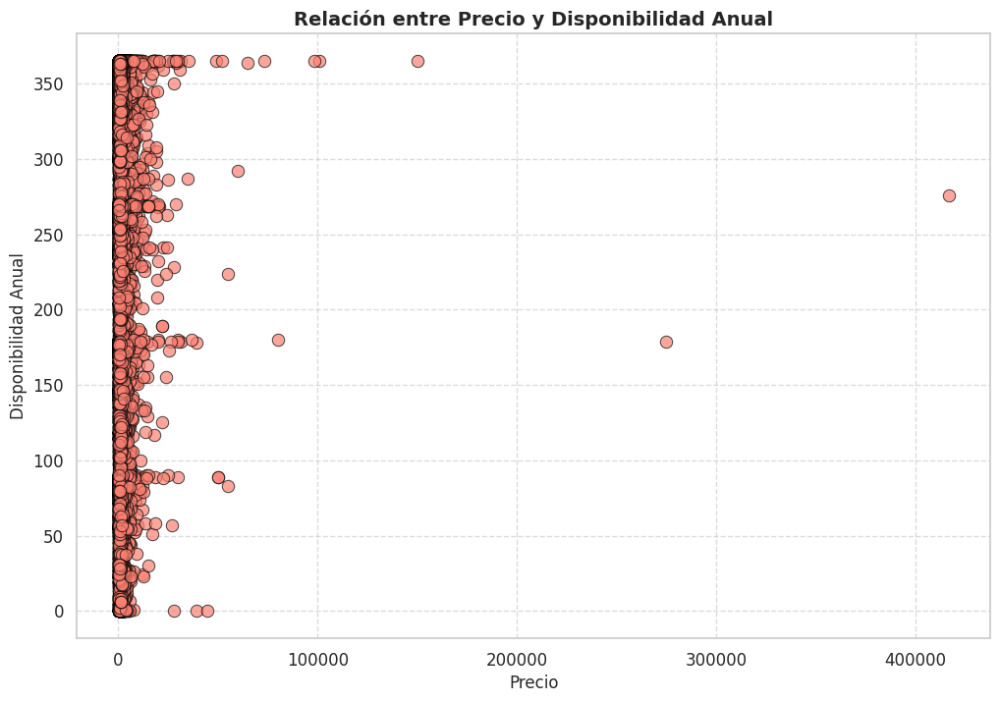

In [14]:
# Crear el gráfico de dispersión
plt.figure(figsize=(12, 8))

# Usar Seaborn para un estilo más refinado
sns.scatterplot(data=df3, x='price', y='availability_365',
                 color='salmon', edgecolor='black', alpha=0.7, s=80)

# Mejorar la estética del gráfico
plt.title('Relación entre Precio y Disponibilidad Anual', fontsize=14, fontweight='bold')
plt.xlabel('Precio', fontsize=12)
plt.ylabel('Disponibilidad Anual', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Mostrar el gráfico
plt.show()

### Mapa de Ciudad de México

In [15]:
# Crear un mapa de calor con folium
MX = folium.Map(location=[19.3713, -99.1455], zoom_start=11.5)

# List comprehension para preparar los datos para el mapa
heat_data = [[row['latitude'], row['longitude']] for index, row in df3.iterrows()]

# Añadir el mapa de calor
HeatMap(
    heat_data,
    radius=20,        # Tamaño de cada punto
    blur=10,          # Nivel de difuminado
    min_opacity=0.25,  # Opacidad mínima
    max_zoom=1,       # Nivel máximo de zoom
    opacity=0.5      # Opacidad general del mapa
).add_to(MX)

# Mostrar el mapa
MX

### Análisis de Densidad y Ajuste de Modelos

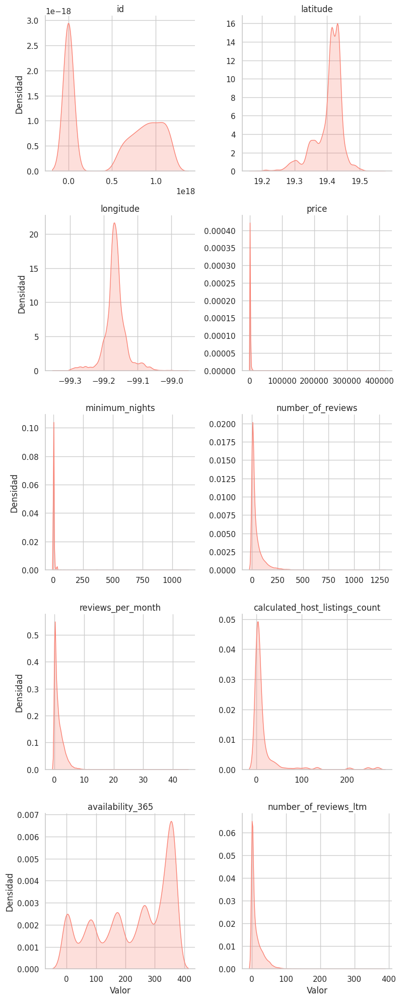

In [16]:
# Seleccionar solo las columnas numéricas
numeric_df = df3.select_dtypes(include=[np.number])

# Transformar el DataFrame en formato largo para FacetGrid
melted_df = numeric_df.melt(var_name='Variable', value_name='Value')

# Crear el gráfico de densidad usando FacetGrid
g = sns.FacetGrid(melted_df, col="Variable", col_wrap=2, height=4, sharex=False, sharey=False)
g.map(sns.kdeplot, 'Value', fill=True, color='salmon')

# Mejorar el diseño
g.set_titles("{col_name}", fontsize=12)
g.set_axis_labels("Valor", "Densidad")
g.add_legend()

# Añadir un título general a la figura
fig.suptitle('Análisis de Densidad', fontsize=14, fontweight='bold')

# Ajustar el layout para que no se solapen los subplots y el título general
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

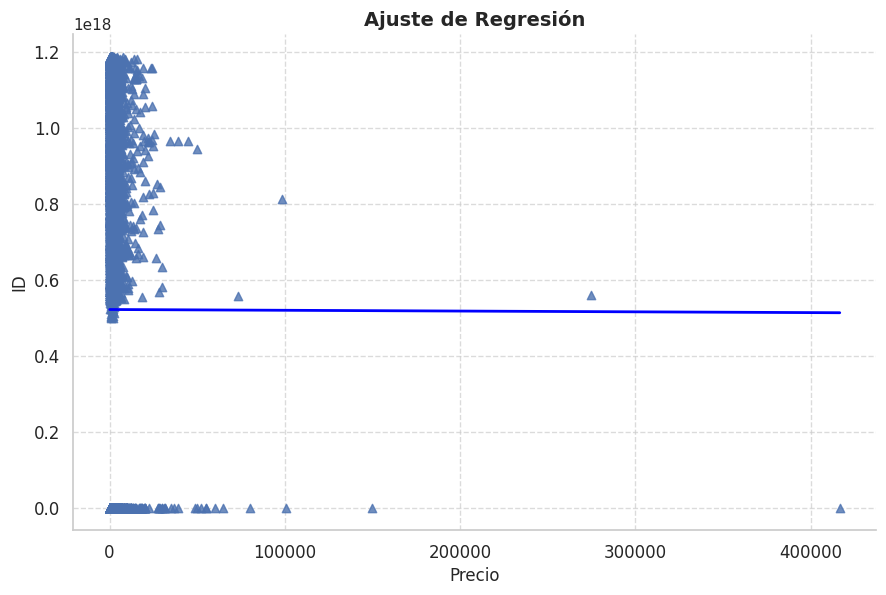

In [17]:
# Crear el gráfico de regresión lineal
sns.lmplot(x='price', y='id', data=df3, logistic=False,
           markers=["^"],
           line_kws={'color': 'blue', 'lw': 2},
           ci=None, # Puedes incluir el intervalo de confianza si es necesario
           height=6, aspect=1.5)  # Ajustar el tamaño del gráfico

# Mejorar la estética del gráfico
plt.title('Ajuste de Regresión', fontsize=14, fontweight='bold')
plt.xlabel('Precio', fontsize=12)
plt.ylabel('ID', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Mostrar el gráfico
plt.show()

In [18]:
# Eliminar valores atípicos en 'minimum_nights'
df3 = df3[df3['minimum_nights'] < 31]

# Verificar los cambios en el DataFrame
print(df3.shape)

(26265, 15)


# Modelos y Predicciones
## Regresión Lineal

In [19]:
# Preparar datos para la regresión lineal
X = df3['price'].values.reshape(-1, 1)
y = df3['availability_365'].values.reshape(-1, 1)

# Verificar si hay NaN en X
print(f'NaNs en X: {np.isnan(X).sum()}')

NaNs en X: 3084


In [20]:
# Eliminar filas con NaN en X e y
df_clean = df3.dropna(subset=['price', 'availability_365'])
X = df_clean['price'].values.reshape(-1, 1)
y = df_clean['availability_365'].values.reshape(-1, 1)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Crear y ajustar el modelo de regresión lineal
regressor = LinearRegression()
regressor.fit(X_train, y_train)

# Mostrar el intercepto y los coeficientes del modelo
print('Intercepto:', regressor.intercept_)
print('Coeficiente:', regressor.coef_)

# Realizar predicciones
y_pred = regressor.predict(X_test)

# Crear un DataFrame para comparar valores reales y predicciones
dfLinReg = pd.DataFrame({'Actual': y_test.flatten(), 'Predicted': y_pred.flatten()})
dfLinReg

Intercepto: [240.87353106]
Coeficiente: [[0.00027223]]


,Actual,Predicted
0,270,240.939684
1,353,241.314821
2,318,241.171354
3,241,241.388052
4,359,240.949756
...,...,...
4632,27,241.145492
4633,269,240.955201
4634,359,241.040682
4635,181,241.119630


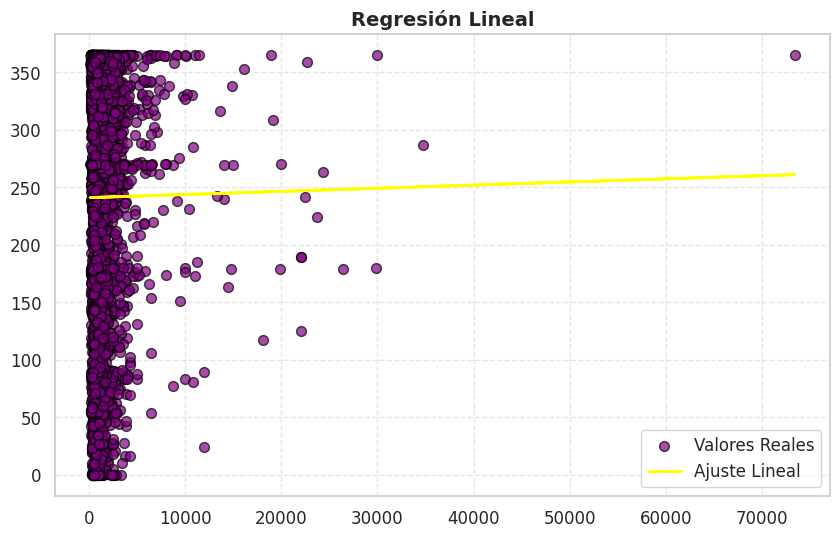

In [21]:
# Crear el gráfico
plt.figure(figsize=(10, 6))

# Puntos reales
plt.scatter(X_test, y_test, color='purple', s=50, edgecolor='black', alpha=0.7, label='Valores Reales')

# Línea de ajuste
plt.plot(X_test, y_pred, color='yellow', linewidth=2, linestyle='-', label='Ajuste Lineal')

# Mejorar la estética del gráfico
plt.title('Regresión Lineal', fontsize=14, fontweight='bold')
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Mostrar el gráfico
plt.show()

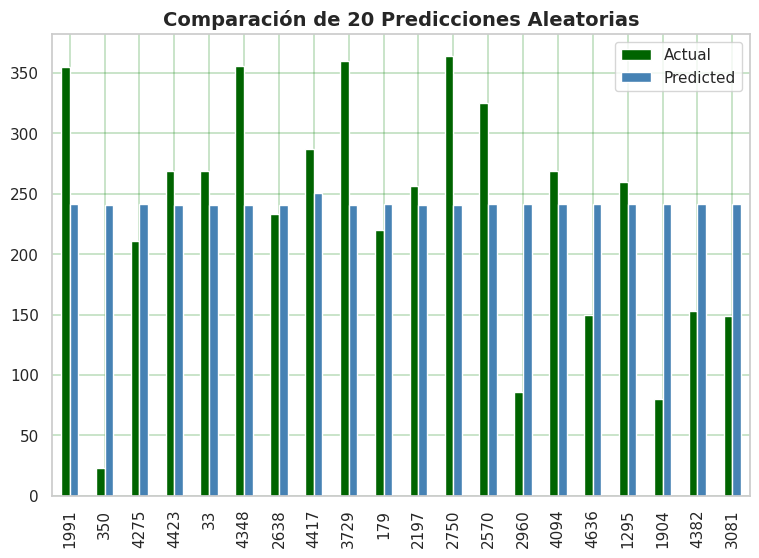

Error Absoluto Medio: 96.24080488976671
Error Cuadrático Medio: 12020.659618288802
Raíz del Error Cuadrático Medio: 109.63876877404635


In [22]:
# Comparar 20 predicciones aleatorias
random20preds = dfLinReg.sample(n=20, random_state=42)
colors = ['darkgreen', 'steelblue']
random20preds.plot(kind='bar', figsize=(9, 6), color=colors)
plt.grid(which='major', linestyle='-', linewidth='0.3', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title('Comparación de 20 Predicciones Aleatorias', fontsize=14, fontweight='bold')
plt.show()

# Evaluar el modelo
print('Error Absoluto Medio:', metrics.mean_absolute_error(y_test, y_pred))
print('Error Cuadrático Medio:', metrics.mean_squared_error(y_test, y_pred))
print('Raíz del Error Cuadrático Medio:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))


## Regresión Múltiple

In [23]:
# Convertir variables categóricas en numéricas
labelencoder = LabelEncoder()
df3['room_type_Cat'] = labelencoder.fit_transform(df3['room_type'])
df3['neigh_Cat'] = labelencoder.fit_transform(df3['neighbourhood'])
df3['del_Cat'] = labelencoder.fit_transform(df3['delegation'])

# Mostrar las primeras filas para verificar la conversión
df3.head()

,id,name,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,delegation,room_type_Cat,neigh_Cat,del_Cat
0,35797,Villa Dante,Dici,Cuajimalpa de Morelos,19.38283,-99.27178,Entire home/apt,3663.0,1,0,0.00,1,363,0,CM,0,3,3
1,898633,City SkyLine View from 1 Bedroom Apt in CDMX,Marco,Cuauhtémoc,19.42063,-99.16586,Entire home/apt,1652.0,3,56,0.41,3,262,3,CU,0,4,5
2,44616,CONDESA HAUS B&B,Fernando,Cuauhtémoc,19.41162,-99.17794,Entire home/apt,18000.0,1,64,0.42,13,364,0,CU,0,4,5
3,913084,15 blocks from Paseo de la Reforma,Martina,Miguel Hidalgo,19.43956,-99.17263,Entire home/apt,814.0,2,161,1.19,1,236,6,MH,0,9,10
4,67703,"2 bedroom apt. deco bldg, Condesa",Nicholas,Cuauhtémoc,19.41152,-99.16857,Entire home/apt,1923.0,2,49,0.32,2,361,4,CU,0,4,5


In [24]:
# Eliminar filas con NaN en las columnas relevantes
df3_clean = df3.dropna(subset=['price', 'calculated_host_listings_count', 'room_type_Cat', 'neigh_Cat', 'del_Cat'])

# Seleccionar características y variable dependiente
X_ = df3_clean[['calculated_host_listings_count', 'room_type_Cat', 'neigh_Cat', 'del_Cat']]
Y = df3_clean['price']

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_, Y, test_size=0.2, random_state=42)

# Crear y ajustar el modelo de regresión múltiple
regr = LinearRegression()
regr.fit(X_train, y_train)

# Mostrar el intercepto y los coeficientes del modelo
print('Intercepto:', regr.intercept_)
print('Coeficientes:', regr.coef_)

# Realizar predicciones
y_pred2 = regr.predict(X_)

# Crear un DataFrame para comparar valores reales y predicciones
dfmult = pd.DataFrame({'Actual': Y, 'Predicted': y_pred2.flatten()})
dfmult

Intercepto: 1606.5137706058745
Coeficientes: [   2.12372041 -404.27087734   -5.15032289   19.48647342]


,Actual,Predicted
0,3663.0,1651.645943
1,1652.0,1689.716007
2,18000.0,1710.953211
3,814.0,1757.149319
4,1923.0,1687.592287
...,...,...
26531,7850.0,1700.334609
26532,1478.0,1706.705771
26533,936.0,1685.468567
26534,768.0,1689.716007


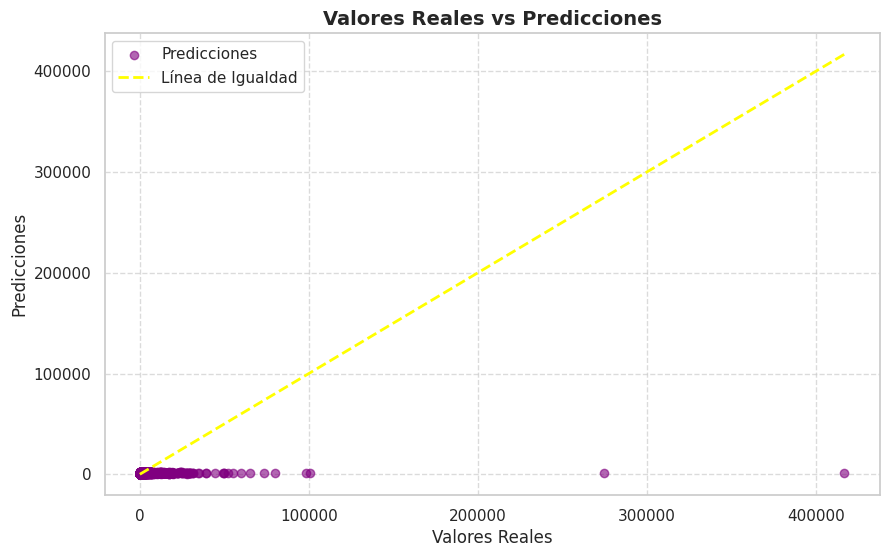

In [25]:
# Graficar los valores reales vs. predicciones
plt.figure(figsize=(10, 6))
plt.scatter(dfmult['Actual'], dfmult['Predicted'], color='purple', alpha=0.6, label='Predicciones')
plt.plot([dfmult['Actual'].min(), dfmult['Actual'].max()],
         [dfmult['Actual'].min(), dfmult['Actual'].max()], color='yellow', linestyle='--', linewidth=2, label='Línea de Igualdad')
plt.title('Valores Reales vs Predicciones', fontsize=14, fontweight='bold')
plt.xlabel('Valores Reales')
plt.ylabel('Predicciones')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

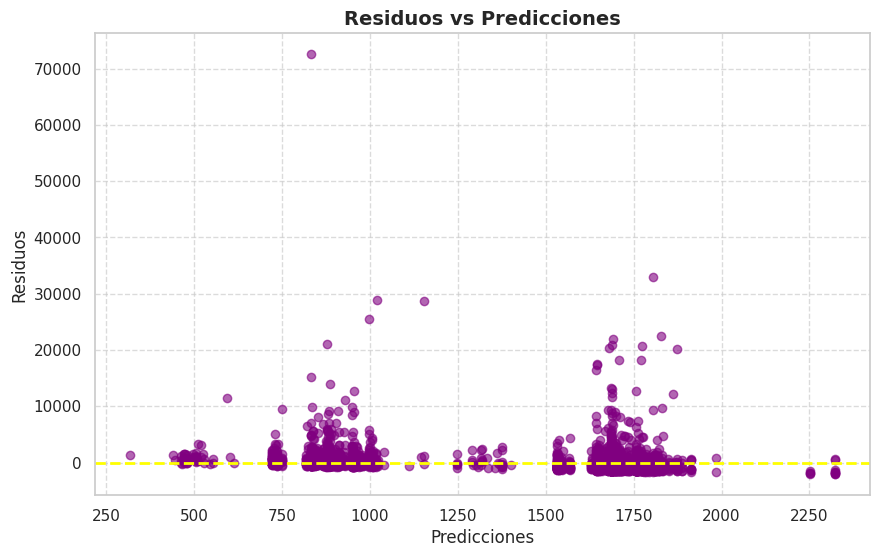

In [26]:
# Calcular los residuos
residuals = y_test - y_pred2[:len(y_test)]

# Graficar residuos
plt.figure(figsize=(10, 6))
plt.scatter(y_pred2[:len(y_test)], residuals, color='purple', alpha=0.6)
plt.axhline(y=0, color='yellow', linestyle='--', linewidth=2)
plt.title('Residuos vs Predicciones', fontsize=14, fontweight='bold')
plt.xlabel('Predicciones')
plt.ylabel('Residuos')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

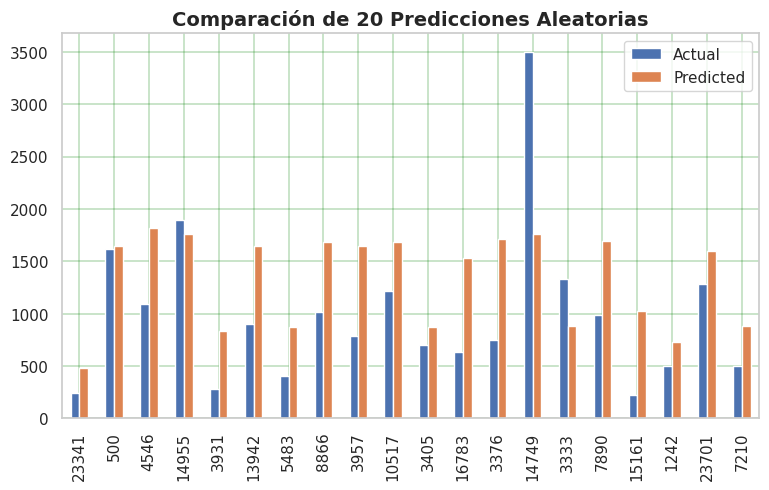

Error Absoluto Medio: 898.5457154380316
Error Cuadrático Medio: 16153599.041172622
Raíz del Error Cuadrático Medio: 4019.1540205835136


In [27]:
# Comparar 20 predicciones aleatorias
random20preds2 = dfmult.sample(n=20, random_state=42)
random20preds2.plot(kind='bar', figsize=(9, 5))
plt.grid(which='major', linestyle='-', linewidth='0.3', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title('Comparación de 20 Predicciones Aleatorias', fontsize=14, fontweight='bold')
plt.show()

# Evaluar el modelo
print('Error Absoluto Medio:', mean_absolute_error(Y, y_pred2))
print('Error Cuadrático Medio:', mean_squared_error(Y, y_pred2))
print('Raíz del Error Cuadrático Medio:', np.sqrt(mean_squared_error(Y, y_pred2)))


##  K-Nearest Neighbors (KNN)

In [28]:
# Resumen estadístico de la columna 'price'
print(df3['price'].describe())

count     23181.000000
mean       1462.892714
std        4041.721813
min         105.000000
25%         600.000000
50%         990.000000
75%        1550.000000
max      416684.000000
Name: price, dtype: float64


In [29]:
# Crear una lista de condiciones ajustadas
conditions = [
    (df3['price'] < 500),
    (df3['price'] >= 500) & (df3['price'] < 2000),
    (df3['price'] >= 2000) & (df3['price'] < 5000),
    (df3['price'] >= 5000)
]

# Crear una lista de los valores que queremos asignar para cada condición
values = ['barato', 'razonable', 'costoso', 'exclusivo']

# Crear una nueva columna y usar np.select para asignar valores usando nuestras listas como argumentos
df3['price_range'] = np.select(conditions, values, default='no definido')

# Contar las ocurrencias de cada rango de precios
price_range_counts = df3['price_range'].value_counts()

print(price_range_counts)

price_range
razonable      15644
barato          3921
no definido     3084
costoso         2947
exclusivo        669
Name: count, dtype: int64


In [30]:
# Crear un mapa base
MX = folium.Map(location=[19.3713, -99.1455], zoom_start=11.5)

# Crear una lista de colores para las categorías
colors = {
    'barato': 'orange',
    'razonable': 'green',
    'costoso': 'blue',
    'exclusivo': 'red'
}

# Añadir los puntos al mapa con colores según la categoría
for _, row in df3.iterrows():
    if row['price_range'] != 'no definido':  # Solo añadir puntos con categorías definidas
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=7,
            color=colors[row['price_range']],
            fill=True,
            fill_color=colors[row['price_range']],
            fill_opacity=0.3,
            opacity=0.5,
            weight=0.3
        ).add_to(MX)

# Añadir una leyenda al mapa
legend_html = '''
    <div style="
        position: fixed;
        bottom: 50px;
        left: 50px;
        width: 160px;
        height: 120px;
        background-color: white;
        border:2px solid black;
        z-index:9999;
        font-size:14px;
        padding: 10px;
        ">
        <b>Rango de Precios</b><br>
        <i class="fa fa-circle" style="color:blue"></i> Barato<br>
        <i class="fa fa-circle" style="color:green"></i> Razonable<br>
        <i class="fa fa-circle" style="color:orange"></i> Costoso<br>
        <i class="fa fa-circle" style="color:red"></i> Exclusivo
    </div>
'''
MX.get_root().html.add_child(folium.Element(legend_html))

# Mostrar el mapa
MX

In [31]:
# Crear una instancia de LabelEncoder
labelencoder = LabelEncoder()

# Asignar valores numéricos y almacenar en otra columna
df3['price_rng_Cat'] = labelencoder.fit_transform(df3['price_range'])

In [32]:
# Seleccionar las columnas relevantes
df4 = df3[['id', 'minimum_nights', 'availability_365', 'number_of_reviews', 'reviews_per_month',
          'calculated_host_listings_count', 'room_type_Cat', 'neigh_Cat', 'del_Cat', 'price', 'price_rng_Cat']]

# Mostrar el mapa de calor de correlación
df4.corr().style.background_gradient(cmap='magma')

,id,minimum_nights,availability_365,number_of_reviews,reviews_per_month,calculated_host_listings_count,room_type_Cat,neigh_Cat,del_Cat,price,price_rng_Cat
id,1.000000,-0.033627,0.094037,-0.379092,0.072039,0.178774,-0.058487,-0.012712,0.025927,0.003102,-0.010646
minimum_nights,-0.033627,1.000000,-0.010916,-0.120313,-0.163038,0.250476,-0.003438,-0.006917,-0.020484,0.005259,-0.056075
availability_365,0.094037,-0.010916,1.000000,0.044118,0.085192,0.153982,0.003990,0.002909,0.000648,0.013195,-0.016836
number_of_reviews,-0.379092,-0.120313,0.044118,1.000000,0.626393,-0.038764,-0.133228,-0.034967,0.013606,-0.030901,0.072730
reviews_per_month,0.072039,-0.163038,0.085192,0.626393,1.000000,0.058391,-0.174227,-0.041030,0.020886,-0.038173,0.076044
calculated_host_listings_count,0.178774,0.250476,0.153982,-0.038764,0.058391,1.000000,-0.135660,-0.013287,0.022831,0.037272,-0.003761
room_type_Cat,-0.058487,-0.003438,0.003990,-0.133228,-0.174227,-0.135660,1.000000,0.015182,-0.015724,-0.101455,-0.319264
neigh_Cat,-0.012712,-0.006917,0.002909,-0.034967,-0.041030,-0.013287,0.015182,1.000000,0.583099,0.007837,-0.034557
del_Cat,0.025927,-0.020484,0.000648,0.013606,0.020886,0.022831,-0.015724,0.583099,1.000000,0.018264,-0.028678
price,0.003102,0.005259,0.013195,-0.030901,-0.038173,0.037272,-0.101455,0.007837,0.018264,1.000000,-0.051386


In [33]:
# Eliminar filas con NaN en df4
df4_clean = df4.dropna()

# Preparar los datos
X1 = df4_clean.iloc[:, :-1].values
Y1 = df4_clean['price_rng_Cat'].values

# Dividir los datos
X_train, X_test, y_train, y_test = train_test_split(X1, Y1, test_size=0.2, random_state=42)

# Estandarizar los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Verificar NaN después de la estandarización
print("NaN en X_train después de estandarización:", np.isnan(X_train).sum())
print("NaN en X_test después de estandarización:", np.isnan(X_test).sum())

# Ajustar el modelo KNN
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X_train, y_train)

# Predicciones
y_pred3 = neigh.predict(X_test)

KNNmod = pd.DataFrame({'Actual': y_test.flatten(), 'Predicted': y_pred3.flatten()})
KNNmod

NaN en X_train después de estandarización: 0
NaN en X_test después de estandarización: 0


,Actual,Predicted
0,0,0
1,4,4
2,4,4
3,4,4
4,0,0
...,...,...
4632,4,4
4633,0,0
4634,4,4
4635,4,4


In [45]:
# Imprimir la métrica de distancia utilizada por defecto
print(f"La métrica de distancia utilizada por defecto es: {neigh.metric}")

La métrica de distancia utilizada por defecto es: minkowski


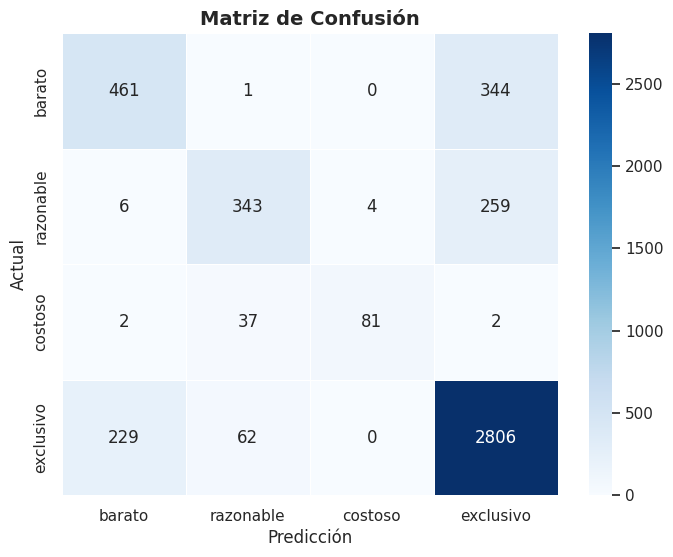

In [34]:
# Generar la matriz de confusión
cm = confusion_matrix(y_test, y_pred3)

# Crear un DataFrame de la matriz de confusión
class_names = ['barato', 'razonable', 'costoso', 'exclusivo']
cm_df = pd.DataFrame(cm, index=class_names, columns=class_names)

# Graficar la matriz de confusión
plt.figure(figsize=(8, 6))
sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues', linewidths=.5)
plt.title('Matriz de Confusión', fontsize=14, fontweight='bold')
plt.xlabel('Predicción')
plt.ylabel('Actual')
plt.show()

In [35]:
# Calcular el accuracy
accuracy = accuracy_score(y_test, y_pred3)

# Calcular el recall
recall = recall_score(y_test, y_pred3, average='weighted')

# Calcular la precision
precision = precision_score(y_test, y_pred3, average='weighted')

# Calcular el F1-score
f1 = f1_score(y_test, y_pred3, average='weighted')

# Calcular la especificidad (specificity) para cada clase
specificity_list = []
num_classes = len(class_names)

for i in range(num_classes):
    TN = np.sum(cm) - (np.sum(cm[i, :]) + np.sum(cm[:, i]) - cm[i, i])
    FP = np.sum(cm[:, i]) - cm[i, i]
    specificity = TN / (TN + FP)
    specificity_list.append(specificity)

# Imprimir los resultados
print(f"Accuracy: {accuracy:.4f}")
print(f"Recall: {recall:.4f}")
print(f"Precision: {precision:.4f}")
print(f"F1-Score: {f1:.4f}")

# Imprimir la especificidad con los nombres de las clases
for idx, class_name in enumerate(class_names):
    print(f"Specificity for class '{class_name}': {specificity_list[idx]:.4f}")

Accuracy: 0.7960
Recall: 0.7960
Precision: 0.7915
F1-Score: 0.7889
Specificity for class 'barato': 0.9381
Specificity for class 'razonable': 0.9752
Specificity for class 'costoso': 0.9991
Specificity for class 'exclusivo': 0.6071


In [36]:
# Evaluar el modelo
print('Precisión del modelo:', neigh.score(X_test, y_test))
print('Raíz del Error Cuadrático Medio:', np.sqrt(metrics.mean_squared_error(y_test, y_pred3)))

Precisión del modelo: 0.7959887858529221
Raíz del Error Cuadrático Medio: 1.6167790673163727


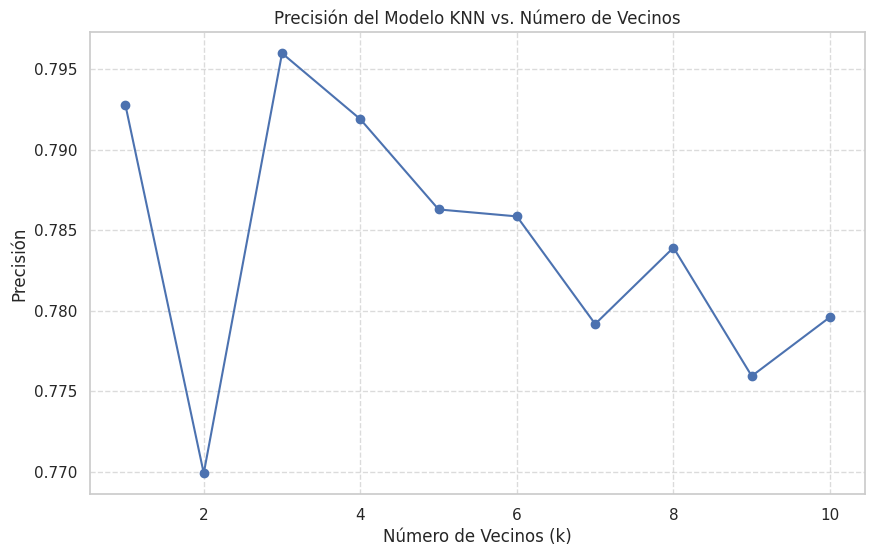

In [37]:
import matplotlib.pyplot as plt

# Calcular precisión para diferentes valores de k
k_values = range(1, 11)
scores = []

for k in k_values:
    model = KNeighborsClassifier(n_neighbors=k)
    model.fit(X_train, y_train)
    scores.append(model.score(X_test, y_test))

# Graficar la precisión
plt.figure(figsize=(10, 6))
plt.plot(k_values, scores, marker='o', linestyle='-', color='b')
plt.title('Precisión del Modelo KNN vs. Número de Vecinos')
plt.xlabel('Número de Vecinos (k)')
plt.ylabel('Precisión')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

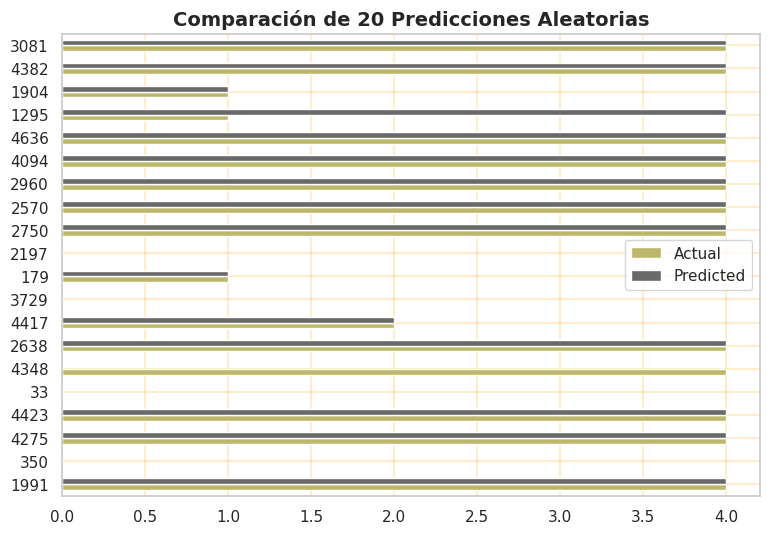

In [38]:
# Seleccionar aleatoriamente 20 predicciones
random20preds3 = KNNmod.sample(n=20, random_state=42)
c2 = ['darkkhaki', 'dimgray']

# Graficar las 20 predicciones aleatorias
random20preds3.plot(kind='barh', figsize=(9, 6), color=c2)
plt.grid(which='major', linestyle='-', linewidth='0.3', color='orange')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title('Comparación de 20 Predicciones Aleatorias', fontsize=14, fontweight='bold')
plt.show()

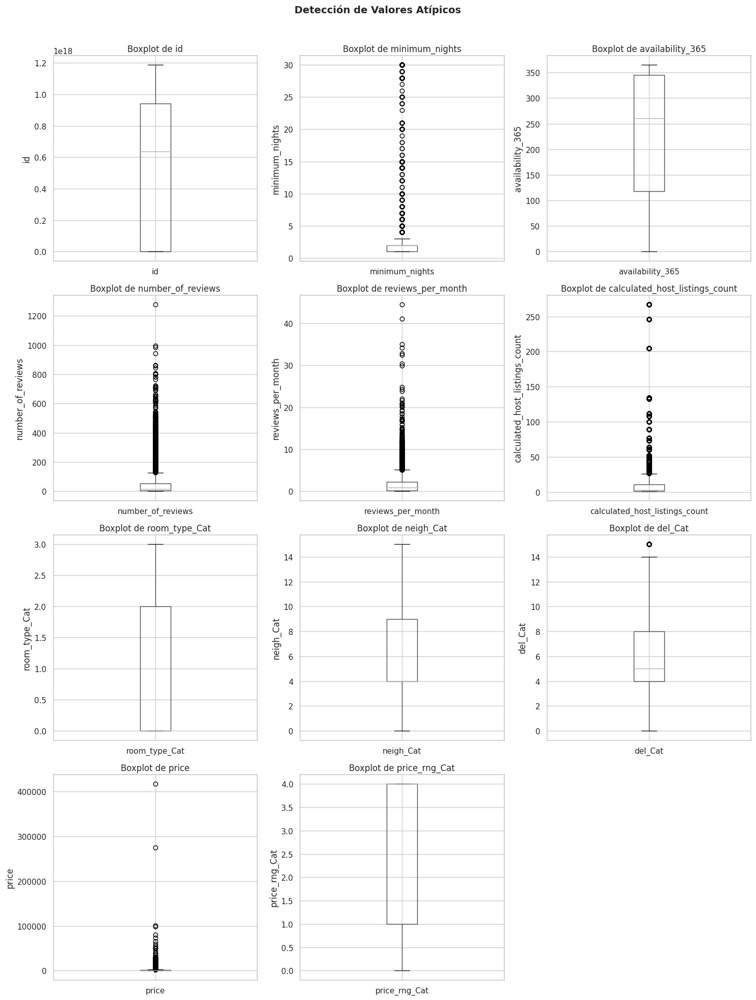

In [39]:
# Seleccionar solo las columnas numéricas de df4
numeric_columns = df4.select_dtypes(include=[np.number]).columns

# Número de columnas numéricas
num_columns = len(numeric_columns)

# Crear una figura con subplots en una cuadrícula de 4x3
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(15, 20))

# Aplanar los ejes para iterar fácilmente si es necesario
axes = axes.flatten()

# Iterar sobre cada columna numérica y crear un boxplot en un subplot
for i, column in enumerate(numeric_columns):
    df4.boxplot(column=column, ax=axes[i])
    axes[i].set_title(f'Boxplot de {column}')
    axes[i].set_ylabel(column)

# Eliminar subplots vacíos si hay menos de 12 columnas
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Añadir un título general a la figura
fig.suptitle('Detección de Valores Atípicos', fontsize=14, fontweight='bold')

# Ajustar el layout para que no se solapen los subplots y el título general
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.show()

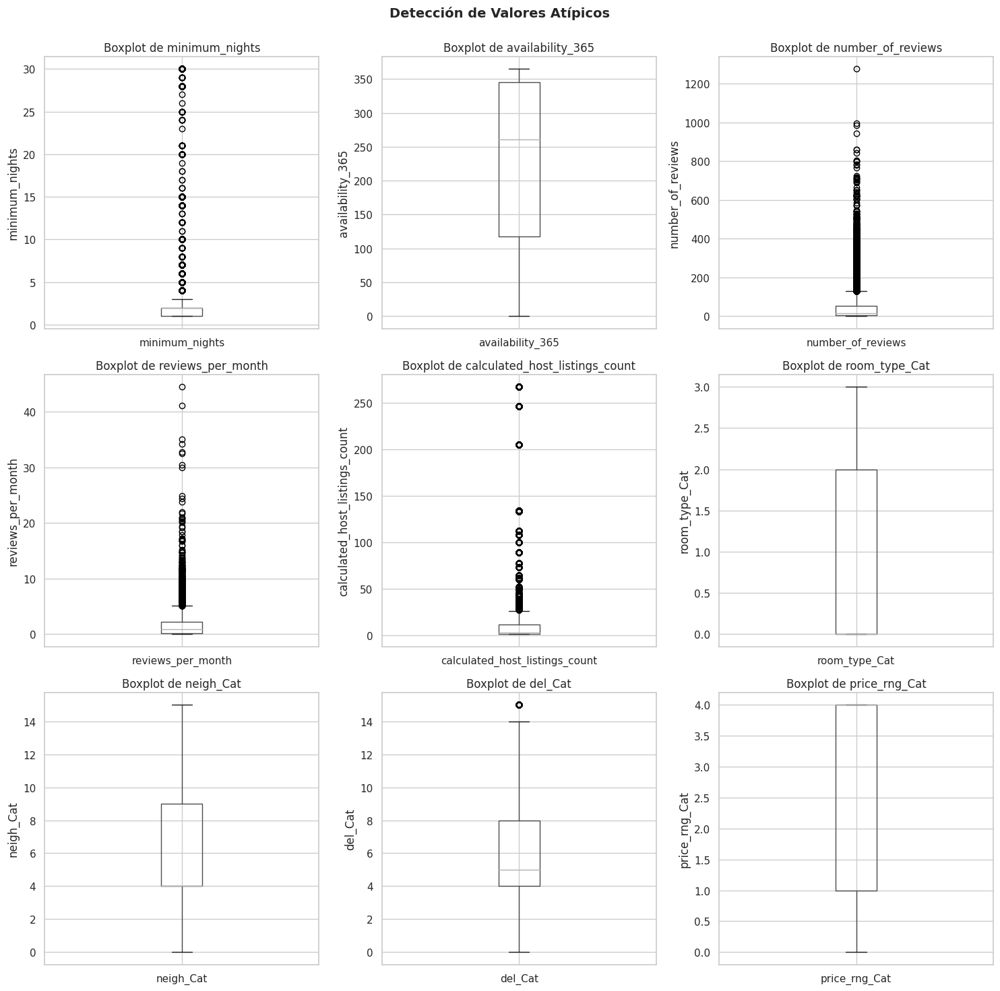

In [40]:
# Columnas específicas para el boxplot
columns = ['minimum_nights', 'availability_365', 'number_of_reviews',
           'reviews_per_month', 'calculated_host_listings_count', 'room_type_Cat',
           'neigh_Cat', 'del_Cat', 'price_rng_Cat']

# Crear una figura con subplots en una cuadrícula de 3x3
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(15, 15))

# Aplanar los ejes para iterar fácilmente
axes = axes.flatten()

# Iterar sobre cada columna y crear un boxplot en un subplot
for i, column in enumerate(columns):
    df4.boxplot(column=column, ax=axes[i])
    axes[i].set_title(f'Boxplot de {column}')
    axes[i].set_ylabel(column)

# Eliminar subplots vacíos si hay menos de 9 columnas
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Añadir un título general a la figura
fig.suptitle('Detección de Valores Atípicos', fontsize=14, fontweight='bold')

# Ajustar el layout para que no se solapen los subplots y el título general
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.show()

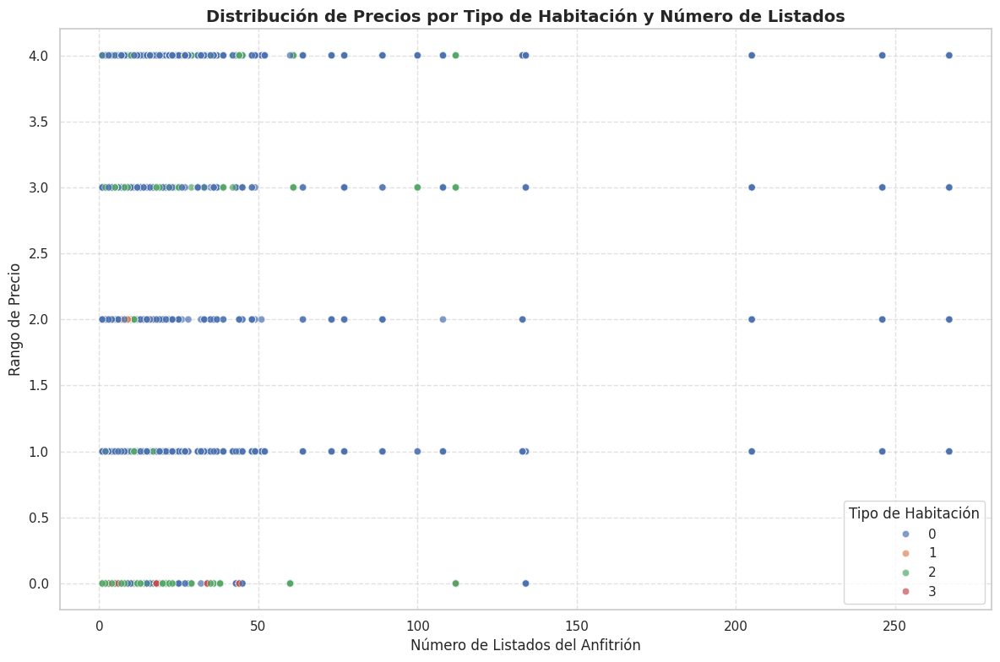

In [41]:
# Configurar el estilo de los gráficos
sns.set(style="whitegrid")

# Crear el gráfico de dispersión
plt.figure(figsize=(12, 8))
scatter_plot = sns.scatterplot(
    data=df4, x="calculated_host_listings_count", y="price_rng_Cat", hue="room_type_Cat",
    sizes=(50, 300), palette='deep', hue_norm=(0, 4), legend="full", alpha=0.7)

# Ajustar el título y las etiquetas
plt.title('Distribución de Precios por Tipo de Habitación y Número de Listados', fontsize=14, fontweight='bold')
plt.xlabel('Número de Listados del Anfitrión', fontsize=12)
plt.ylabel('Rango de Precio', fontsize=12)

# Ajustar la leyenda
plt.legend(title='Tipo de Habitación')

# Mostrar la rejilla
plt.grid(True, linestyle='--', alpha=0.6)

# Ajustar los márgenes
plt.tight_layout()

# Mostrar el gráfico
plt.show()

In [42]:
# Mostrar la matriz de correlación con un mapa de calor
df4.corr().style.background_gradient(cmap='mako')

,id,minimum_nights,availability_365,number_of_reviews,reviews_per_month,calculated_host_listings_count,room_type_Cat,neigh_Cat,del_Cat,price,price_rng_Cat
id,1.000000,-0.033627,0.094037,-0.379092,0.072039,0.178774,-0.058487,-0.012712,0.025927,0.003102,-0.010646
minimum_nights,-0.033627,1.000000,-0.010916,-0.120313,-0.163038,0.250476,-0.003438,-0.006917,-0.020484,0.005259,-0.056075
availability_365,0.094037,-0.010916,1.000000,0.044118,0.085192,0.153982,0.003990,0.002909,0.000648,0.013195,-0.016836
number_of_reviews,-0.379092,-0.120313,0.044118,1.000000,0.626393,-0.038764,-0.133228,-0.034967,0.013606,-0.030901,0.072730
reviews_per_month,0.072039,-0.163038,0.085192,0.626393,1.000000,0.058391,-0.174227,-0.041030,0.020886,-0.038173,0.076044
calculated_host_listings_count,0.178774,0.250476,0.153982,-0.038764,0.058391,1.000000,-0.135660,-0.013287,0.022831,0.037272,-0.003761
room_type_Cat,-0.058487,-0.003438,0.003990,-0.133228,-0.174227,-0.135660,1.000000,0.015182,-0.015724,-0.101455,-0.319264
neigh_Cat,-0.012712,-0.006917,0.002909,-0.034967,-0.041030,-0.013287,0.015182,1.000000,0.583099,0.007837,-0.034557
del_Cat,0.025927,-0.020484,0.000648,0.013606,0.020886,0.022831,-0.015724,0.583099,1.000000,0.018264,-0.028678
price,0.003102,0.005259,0.013195,-0.030901,-0.038173,0.037272,-0.101455,0.007837,0.018264,1.000000,-0.051386


<ipython-input-43-6bc9ae91141b>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bar_plot = sns.barplot(x=price_range_counts.index, y=price_range_counts.values, palette='viridis', alpha=0.9)


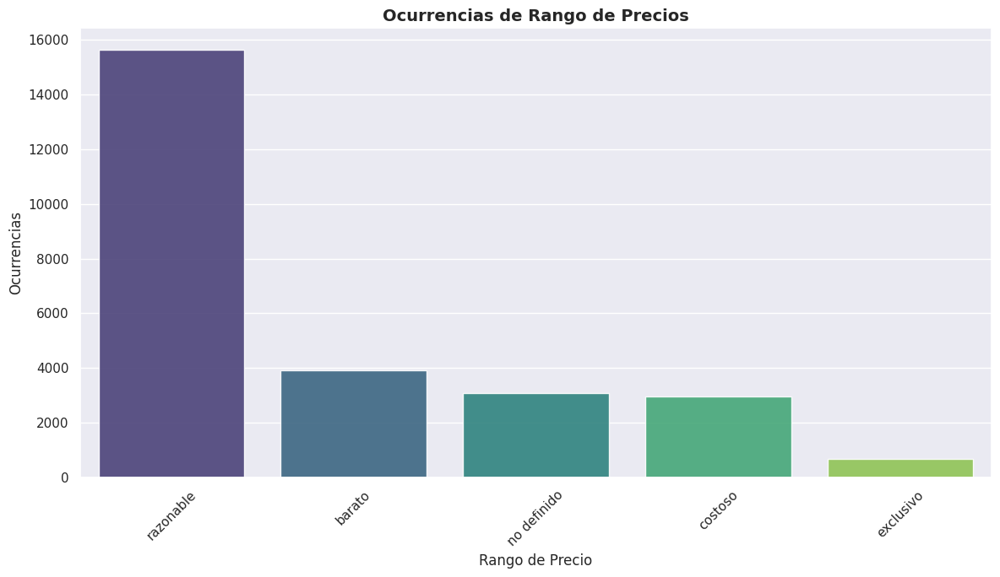

In [43]:
# Contar las ocurrencias de cada rango de precios
price_range_counts = df3['price_range'].value_counts()

# Configurar el estilo del gráfico
sns.set(style="darkgrid")

# Crear el gráfico de barras
plt.figure(figsize=(12, 7))
bar_plot = sns.barplot(x=price_range_counts.index, y=price_range_counts.values, palette='viridis', alpha=0.9)

# Agregar títulos y etiquetas
plt.title('Ocurrencias de Rango de Precios', fontsize=14, fontweight='bold')
plt.ylabel('Ocurrencias', fontsize=12)
plt.xlabel('Rango de Precio', fontsize=12)

# Ajustar la rotación de las etiquetas del eje x si es necesario
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

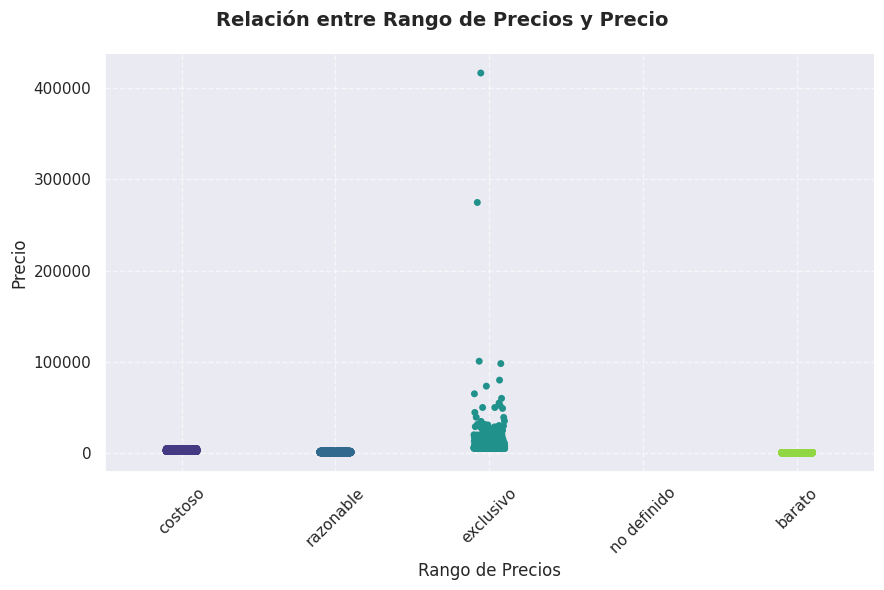

In [44]:
# Crear el gráfico de categorías
g = sns.catplot(
    x='price_range', y='price', data=df3,
    kind='strip',  # O 'swarm' si prefieres una visualización sin superposición
    jitter=True,  # Añade un poco de dispersión para evitar la superposición de puntos
    palette='viridis',  # Paleta de colores atractiva
    height=6,  # Altura del gráfico
    aspect=1.5,  # Relación de aspecto
    hue='price_range',  # Hue para aplicar colores diferentes por categoría
    legend=False  # Desactivar la leyenda para evitar confusión
)

# Ajustar el título y las etiquetas
g.set_axis_labels('Rango de Precios', 'Precio')
g.fig.suptitle('Relación entre Rango de Precios y Precio', fontsize=14, fontweight='bold')

# Ajustar la apariencia de los ejes
plt.xticks(rotation=45)  # Rote las etiquetas del eje x si es necesario
plt.grid(True, linestyle='--', alpha=0.6)  # Agrega una rejilla para mejorar la legibilidad

# Ajustar el layout
plt.tight_layout()

# Mostrar el gráfico
plt.show()